In [1]:
using Plots

include("src/HPMC.jl")
using .HPMC

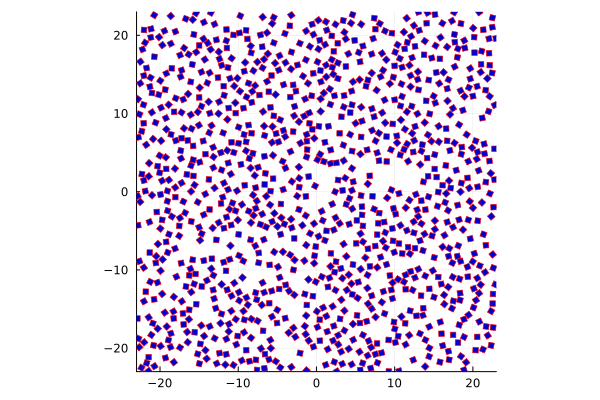

In [2]:
n = 1024
sim = HPMC.HPMCSimulation(n, 4, 0.5, (ceil(Int, √(2n)), ceil(Int, √(2n))), gpu=true)
HPMC.crystallize!(sim.particles)
sim.move_radius = 0.25
sim.rotation_span = π / 8
push!(sim.recorders, HPMC.TrajectoryRecorder(t -> t % (n ÷ 12) == 0, savetomem=true))
HPMC.run!(sim, 5n)
plot(sim.particles)

Plots.AnimatedGif("d:\\University\\HPMC\\code\\anim\\mix.gif")
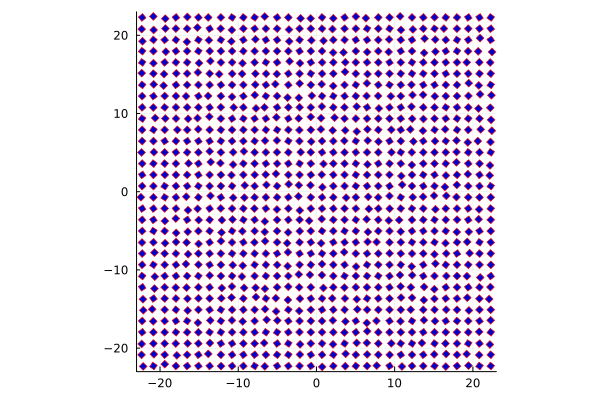

┌ Info: Saved animation to d:\University\HPMC\code\anim\mix.gif
└ @ Plots C:\Users\SLHHe\.julia\packages\Plots\sxUvK\src\animation.jl:156


In [3]:
anim = Animation("../anim/frames/", String[])
for i in 1:length(sim.recorders[1].trajectory)
    p = plot(sim.recorders[1].trajectory[i])
    frame(anim, p)
end
anim_out = gif(anim, "../anim/mix.gif", fps=15)
rm("../anim/frames", recursive=true)
mkdir("../anim/frames")
display(anim_out)

In [4]:
pop!(sim.recorders)
push!(sim.recorders, HPMC.TrajectoryRecorder(t -> t % (n ÷ 4) == 0, savetomem=true))

1-element Vector{Main.HPMC.AbstractRecorder}:
 TrajectoryRecorder(nothing, 0, nothing, true, false, var"#13#14"())

In [5]:
p_area = HPMC.particlearea(sim.particles)
initial_area_fraction = (HPMC.particlecount(sim.particles) * p_area
                         / HPMC.boxarea(sim.particles))

0.24196597353497165

In [6]:
final_area_fraction = 0.8
target_sidelen = Float32(√(HPMC.particlecount(sim.particles) * p_area / final_area_fraction))

25.298222f0

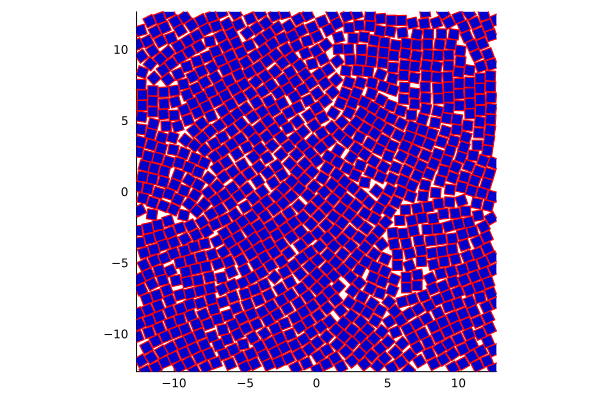

In [7]:
push!(sim.updaters, HPMC.MoveSizeTuner(t -> t % 10 == 0, 0.5;
    max_move_radius=0.25, max_rotation_span=π/8))
push!(sim.updaters, HPMC.ForcefulCompressor(
    t -> t % 20 == 0, (target_sidelen, target_sidelen)))
HPMC.run!(sim, 30n)
plot(sim.particles)

Plots.AnimatedGif("d:\\University\\HPMC\\code\\anim\\compress.gif")
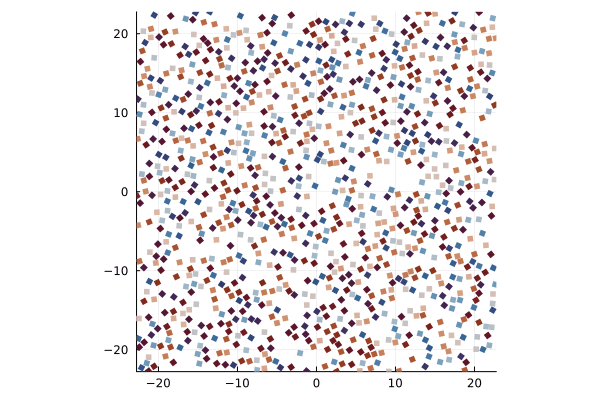

┌ Info: Saved animation to d:\University\HPMC\code\anim\compress.gif
└ @ Plots C:\Users\SLHHe\.julia\packages\Plots\sxUvK\src\animation.jl:156


In [8]:
anim = Animation("../anim/frames/", String[])
for i in 1:length(sim.recorders[1].trajectory)
    snapshot = sim.recorders[1].trajectory[i]
    p = plot(snapshot, mod.(Array(snapshot.angles), π/2) / (π/2))
    frame(anim, p)
end
anim_out = gif(anim, "../anim/compress.gif", fps=15)
rm("../anim/frames", recursive=true)
mkdir("../anim/frames")
display(anim_out)

In [9]:
pop!(sim.recorders)
push!(sim.recorders, HPMC.TrajectoryRecorder(t -> t % n == 0, savetomem=true))

1-element Vector{Main.HPMC.AbstractRecorder}:
 TrajectoryRecorder(nothing, 0, nothing, true, false, var"#19#20"())

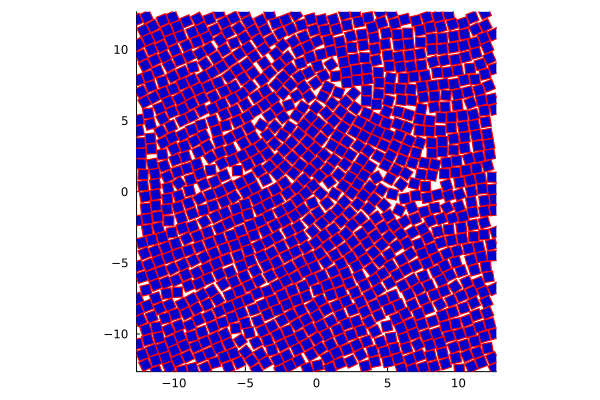

In [10]:
HPMC.run!(sim, 60n)
plot(sim.particles)

Plots.AnimatedGif("d:\\University\\HPMC\\code\\anim\\equilibrium.gif")
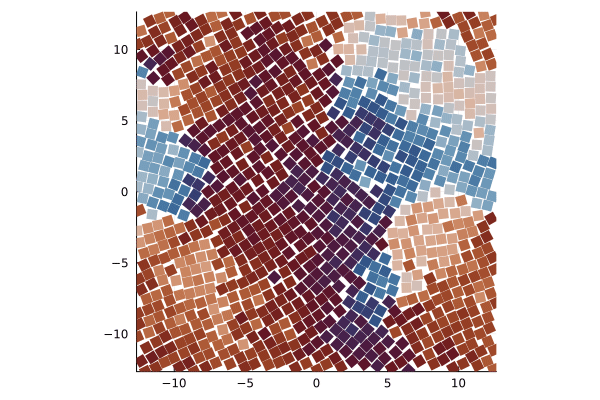

┌ Info: Saved animation to d:\University\HPMC\code\anim\equilibrium.gif
└ @ Plots C:\Users\SLHHe\.julia\packages\Plots\sxUvK\src\animation.jl:156


In [11]:
anim = Animation("../anim/frames/", String[])
for i in 1:length(sim.recorders[1].trajectory)
    snapshot = sim.recorders[1].trajectory[i]
    p = plot(snapshot, mod.(Array(snapshot.angles), π/2) / (π/2))
    frame(anim, p)
end
anim_out = gif(anim, "../anim/equilibrium.gif", fps=15)
rm("../anim/frames", recursive=true)
mkdir("../anim/frames")
display(anim_out)